In [14]:
#   CITIES OF TOMORROW – URBAN SUSTAINABILITY ANALYSIS
#   Microsoft Fabric Data Days Notebooks Contest – Nov 2025
#   Author - Hrituraj Saha

In [15]:
# INSTALL DEPENDENCIES
!pip install xgboost shap plotly folium reportlab

In [16]:
# IMPORTS
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import seaborn as sns
import shap
import folium
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from IPython.display import display, Markdown
from reportlab.platypus import SimpleDocTemplate, Paragraph
from reportlab.lib.styles import getSampleStyleSheet

In [17]:
# LOAD DATA
df = pd.read_csv('Dataset.csv')
display(df.head())

,building_density,road_connectivity,public_transport_access,air_quality_index,green_cover_percentage,carbon_footprint,population_density,crime_rate,avg_income,renewable_energy_usage,disaster_risk_index,land_use_type_Commercial,land_use_type_Green Space,land_use_type_Industrial,land_use_type_Residential,urban_sustainability_score
0,0.367915,0.393821,0.428129,0.414830,0.238555,0.921950,0.126449,0.547160,0.932412,0.382358,0.446242,0.0,0.0,1.0,0.0,0.259239
1,0.414306,0.608445,0.658481,0.490982,0.917681,0.178213,0.325124,0.764042,0.903241,0.377167,0.936824,0.0,1.0,0.0,0.0,0.576923
2,0.827902,0.444679,0.263853,0.264529,0.077883,0.295159,0.042150,0.575736,0.208098,0.237949,0.463054,0.0,0.0,0.0,1.0,0.252844
3,0.733936,0.742708,0.012022,0.486974,0.427303,0.975900,0.663838,0.826727,0.258951,0.876539,0.204293,0.0,0.0,1.0,0.0,0.409002
4,0.769643,0.228268,0.519082,0.945892,0.532321,0.370856,0.429912,0.127542,0.180394,0.679006,0.151421,0.0,0.0,1.0,0.0,0.686376


In [18]:
# DATA OVERVIEW
display(df.describe())
display(df.isna().sum())
Markdown("## No missing values → dataset is clean and ready.")

,building_density,road_connectivity,public_transport_access,air_quality_index,green_cover_percentage,carbon_footprint,population_density,crime_rate,avg_income,renewable_energy_usage,disaster_risk_index,land_use_type_Commercial,land_use_type_Green Space,land_use_type_Industrial,land_use_type_Residential,urban_sustainability_score
count,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000,3476.000000
mean,0.496345,0.490205,0.501397,0.494445,0.505579,0.509657,0.502158,0.499659,0.491556,0.499881,0.494002,0.252301,0.246835,0.241945,0.258918,0.482871
std,0.287770,0.287484,0.287163,0.287185,0.288395,0.288139,0.286912,0.284553,0.285484,0.290146,0.287720,0.434396,0.431232,0.428323,0.438104,0.169391
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.249740,0.241686,0.256093,0.246493,0.256761,0.269287,0.254415,0.255697,0.242244,0.245107,0.243494,0.000000,0.000000,0.000000,0.000000,0.360202
50%,0.495439,0.483176,0.499168,0.488978,0.513606,0.507030,0.505622,0.499045,0.496457,0.498264,0.493688,0.000000,0.000000,0.000000,0.000000,0.482517
75%,0.745671,0.734190,0.752051,0.745491,0.757637,0.755210,0.750379,0.739293,0.730656,0.752263,0.739163,1.000000,0.000000,0.000000,1.000000,0.606625
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


,0
building_density,0
road_connectivity,0
public_transport_access,0
air_quality_index,0
green_cover_percentage,0
carbon_footprint,0
population_density,0
crime_rate,0
avg_income,0
renewable_energy_usage,0


## No missing values → dataset is clean and ready.

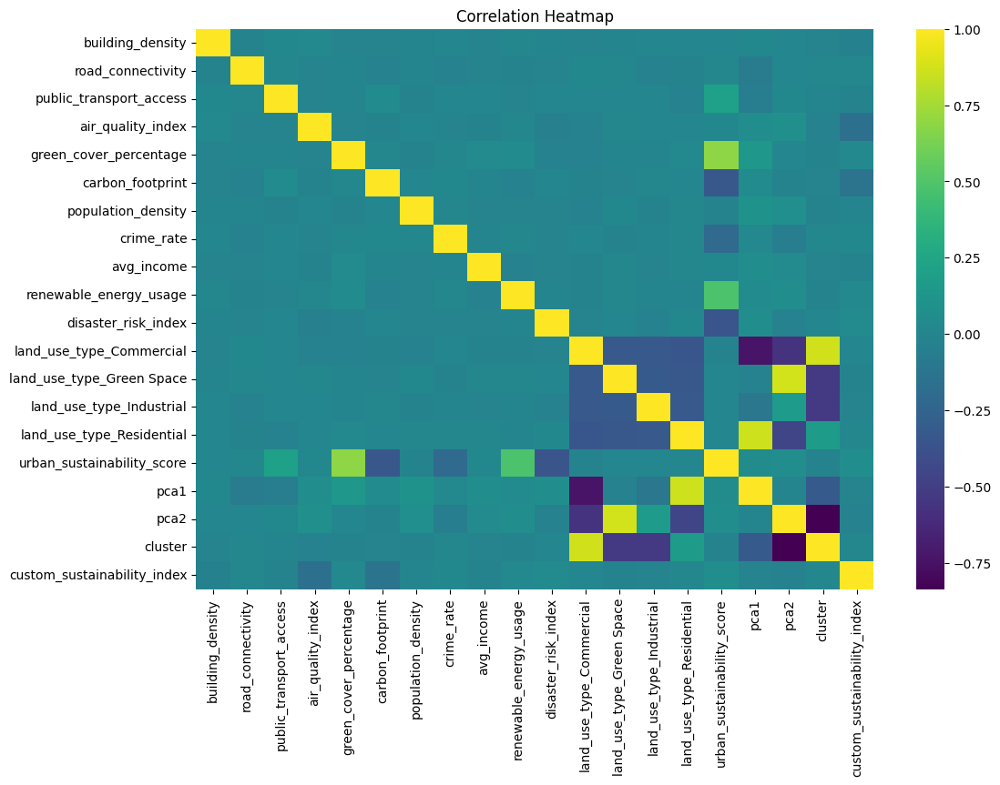

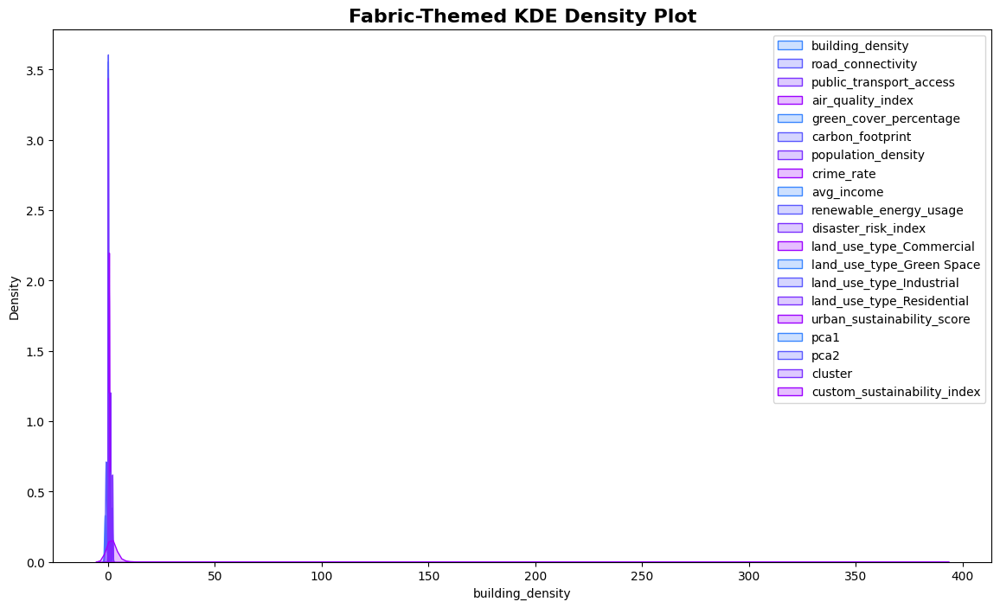

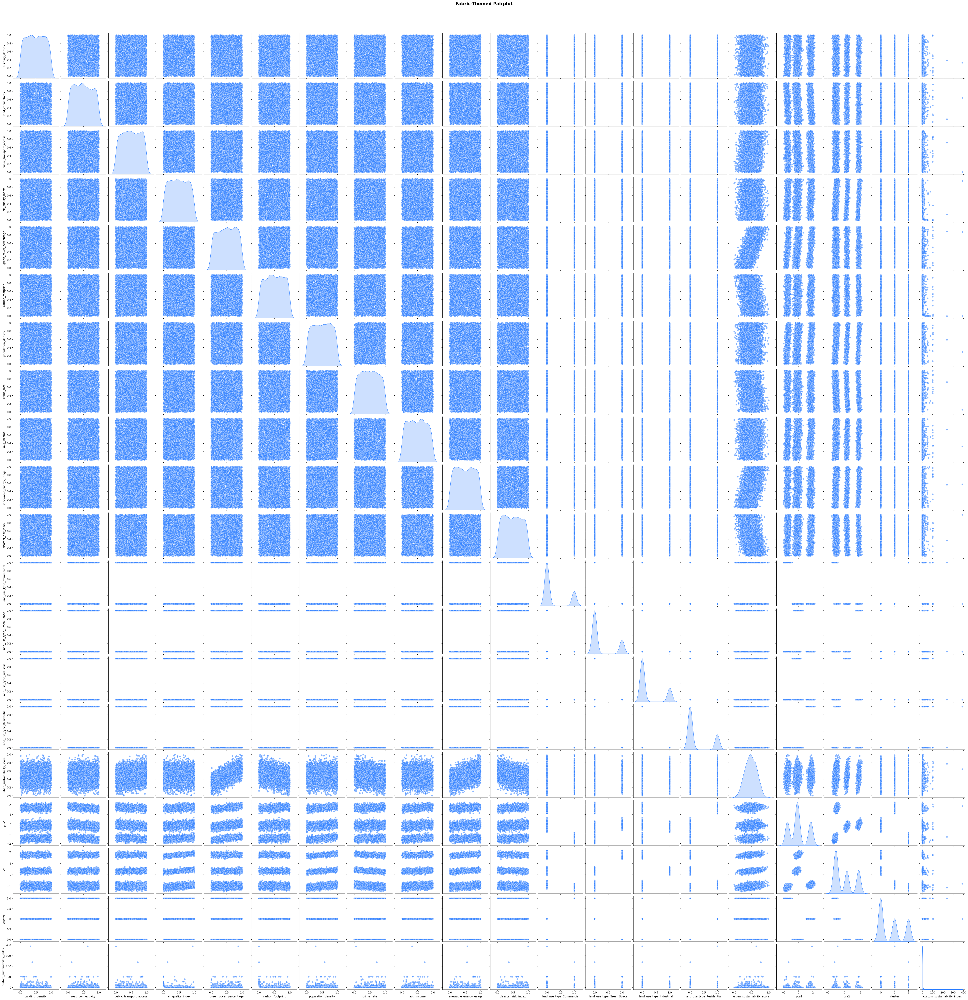

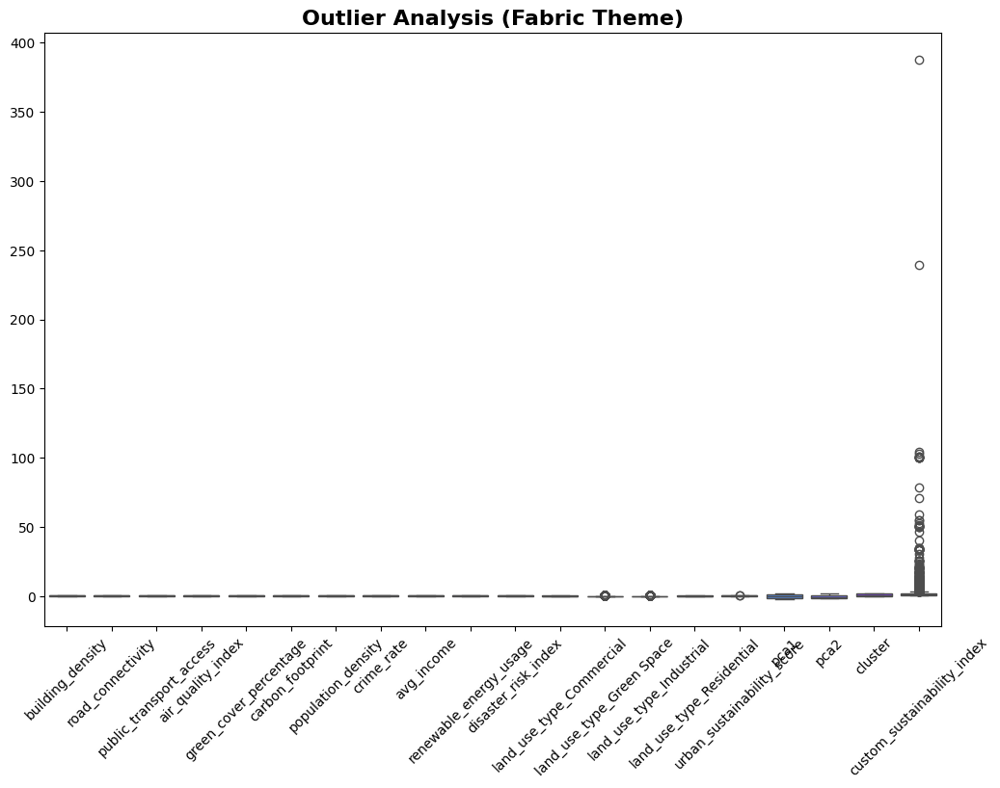

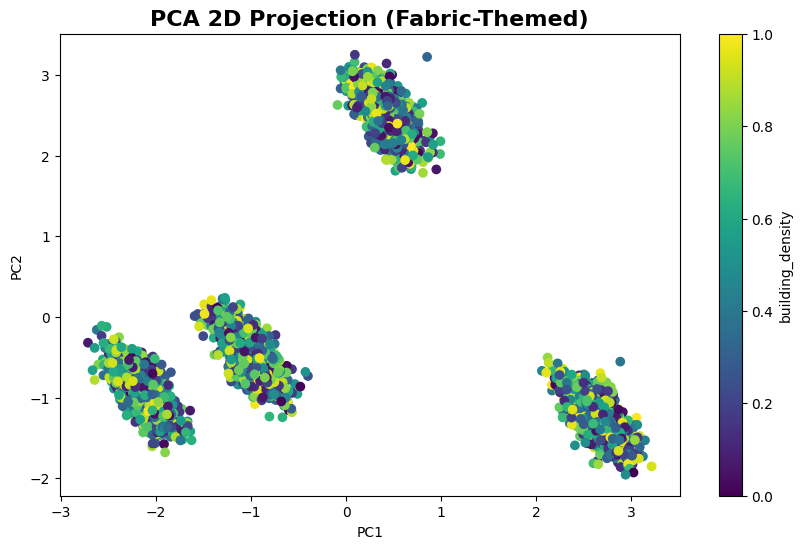

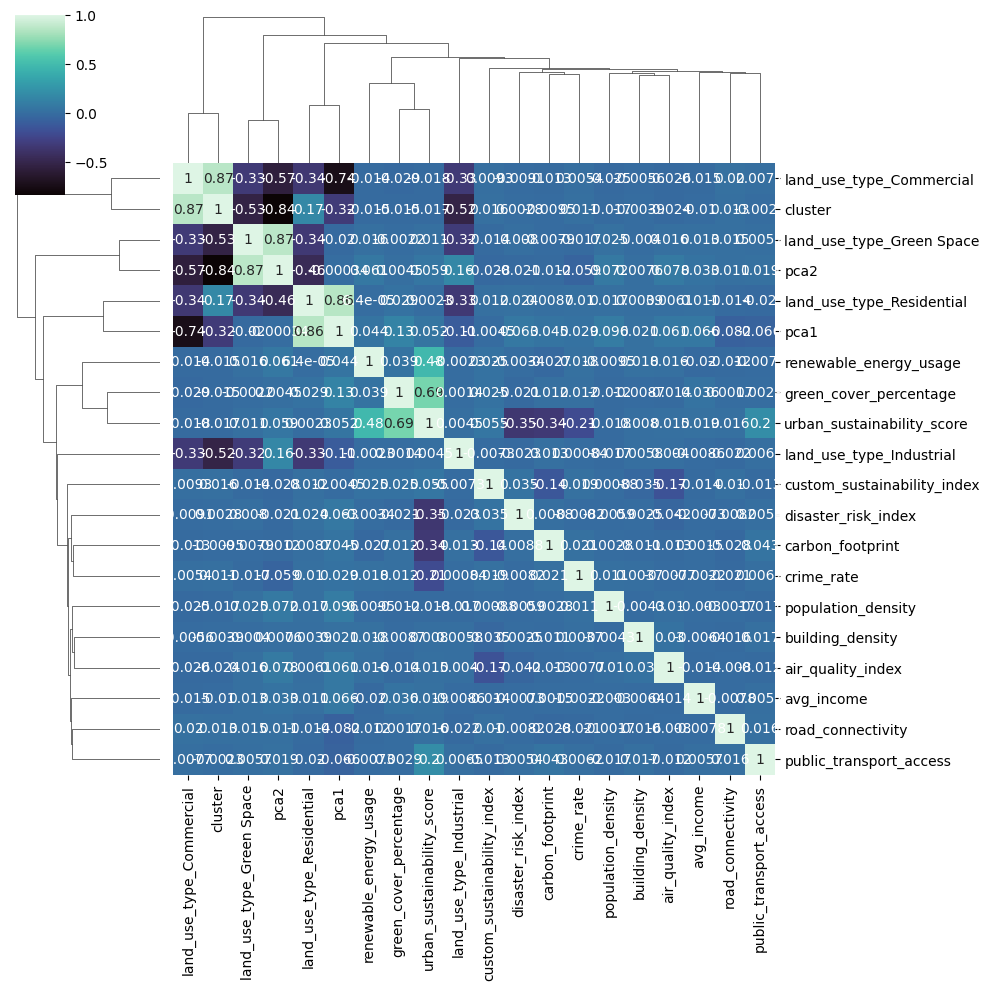

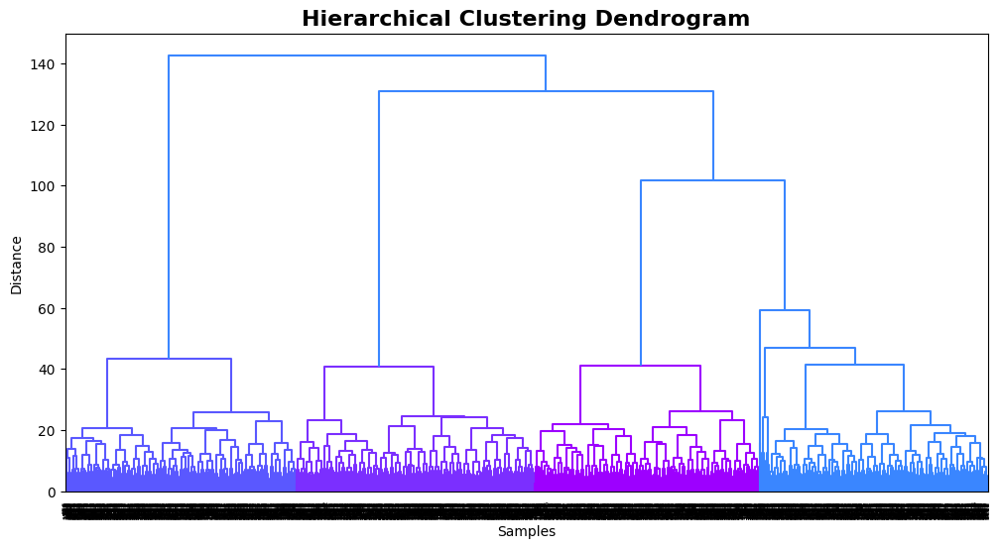

In [38]:
# EXPLORATORY DATA ANALYSIS (EDA)

# CORRELATION HEATMAP
plt.figure(figsize=(12,8))
sns.heatmap(df.corr(numeric_only=True), annot=False, cmap="viridis")
plt.title("Correlation Heatmap")
plt.show()

# FABRIC THEME COLOR PALETTE
fabric_colors = ["#3A86FF", "#5A58FF", "#7B2FFF", "#9D00FF"]

# FIX NaN/INF BEFORE ANY ADVANCED PLOTS
import numpy as np
df.replace([np.inf, -np.inf], np.nan, inplace=True)
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True)
numeric_cols = df.select_dtypes(include='number').columns

# KDE DENSITY PLOTS
extended_palette = (fabric_colors * ((len(numeric_cols) // len(fabric_colors)) + 1))[:len(numeric_cols)]
plt.figure(figsize=(14, 8))
for col, color in zip(numeric_cols, extended_palette):
    sns.kdeplot(df[col], fill=True, label=col, color=color)
plt.title("Fabric-Themed KDE Density Plot", fontsize=16, weight='bold')
plt.legend()
plt.show()

# PAIRPLOT
sns.set_palette(fabric_colors)
sns.pairplot(df[numeric_cols], diag_kind='kde', plot_kws={"alpha":0.6})
plt.suptitle("Fabric-Themed Pairplot", y=1.02, fontsize=16, weight='bold')
plt.show()

# OUTLIER ANALYSIS (BOXPLOT)
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[numeric_cols], palette=extended_palette)
plt.title("Outlier Analysis (Fabric Theme)", fontsize=16, weight='bold')
plt.xticks(rotation=45)
plt.show()

# PCA (2D VISUALIZATION)
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
X = df[numeric_cols]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_scaled)
plt.figure(figsize=(10, 6))
sc = plt.scatter(pca_result[:, 0], pca_result[:, 1], c=df[numeric_cols[0]], cmap="viridis")
plt.title("PCA 2D Projection (Fabric-Themed)", fontsize=16, weight='bold')
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.colorbar(sc, label=numeric_cols[0])
plt.show()

# CLUSTER HEATMAP
sns.clustermap(df[numeric_cols].corr(), cmap="mako", annot=True)
plt.show()

# DENDROGRAM (HIERARCHICAL CLUSTERING)
from scipy.cluster.hierarchy import dendrogram, linkage
linked = linkage(X_scaled, method='ward')
plt.figure(figsize=(12, 6))
dendrogram(linked)
plt.title("Hierarchical Clustering Dendrogram", fontsize=16, weight='bold')
plt.xlabel("Samples")
plt.ylabel("Distance")
plt.show()

In [29]:
# INTERACTIVE DASHBOARD
fig = px.scatter(
    df,
    x="green_cover_percentage",
    y="air_quality_index",
    color="urban_sustainability_score",
    title="Interactive Urban Sustainability Dashboard",
    size="renewable_energy_usage",
    hover_data=df.columns
)
fig.show()
fig = px.histogram(
    df,
    x="urban_sustainability_score",
    nbins=20,
    title="Distribution of Sustainability Score",
    color="urban_sustainability_score",
    template="plotly_white"
)
fig.show()
fig = px.box(
    df,
    y=["air_quality_index", "crime_rate", "carbon_footprint"],
    title="Environmental & Social Risk Indicators",
    template="plotly_white"
)
fig.show()

In [21]:
# PCA + CLUSTER ANALYSIS
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df.drop(columns=["urban_sustainability_score"]))
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_scaled)
df["pca1"] = pca_result[:,0]
df["pca2"] = pca_result[:,1]
kmeans = KMeans(n_clusters=3, random_state=42)
df["cluster"] = kmeans.fit_predict(X_scaled)
fig = px.scatter(
    df, x="pca1", y="pca2",
    color=df["cluster"].astype(str),
    title="City Clusters (PCA 2D Projection)",
    hover_data=df.columns
)
fig.show()

In [22]:
# MODEL TRAINING
X = df.drop(columns=["urban_sustainability_score"])
y = df["urban_sustainability_score"]
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# RANDOM FOREST
rf = RandomForestRegressor(n_estimators=300, random_state=42)
rf.fit(X_train, y_train)
rf_pred = rf.predict(X_test)
rf_rmse = (mean_squared_error(y_test, rf_pred))**0.5
rf_r2 = r2_score(y_test, rf_pred)
print("Random Forest RMSE:", rf_rmse)
print("Random Forest R2:", rf_r2)

# XGBOOST
xgb = XGBRegressor(
    n_estimators=300,
    learning_rate=0.05,
    max_depth=6,
    subsample=0.8,
    colsample_bytree=0.8
)
xgb.fit(X_train, y_train)
xgb_pred = xgb.predict(X_test)
xgb_rmse = (mean_squared_error(y_test, xgb_pred))**0.5
xgb_r2 = r2_score(y_test, xgb_pred)
print("XGBoost RMSE:", xgb_rmse)
print("XGBoost R2:", xgb_r2)

Random Forest RMSE: 0.041761737593338344
Random Forest R2: 0.9424233518483647
XGBoost RMSE: 0.020014595567121443
XGBoost R2: 0.9867753893153339


In [34]:
# FEATURE IMPORTANCE
fi = pd.DataFrame({
    "feature": X.columns,
    "importance": rf.feature_importances_
}).sort_values(by="importance", ascending=False)
fig = px.bar(
    fi,
    x="importance",
    y="feature",
    title="Feature Importance (Random Forest)",
    orientation="h",
    template="plotly_white"
)
fig.show()
fi.head()

,feature,importance
4,green_cover_percentage,0.474416
9,renewable_energy_usage,0.211287
10,disaster_risk_index,0.107243
5,carbon_footprint,0.101991
2,public_transport_access,0.036771


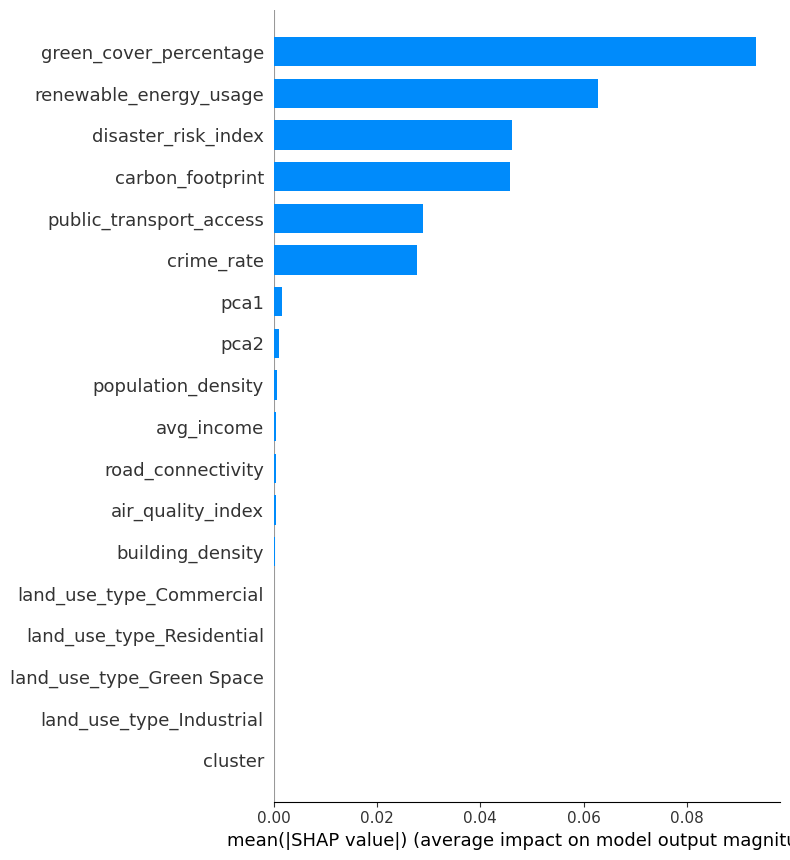

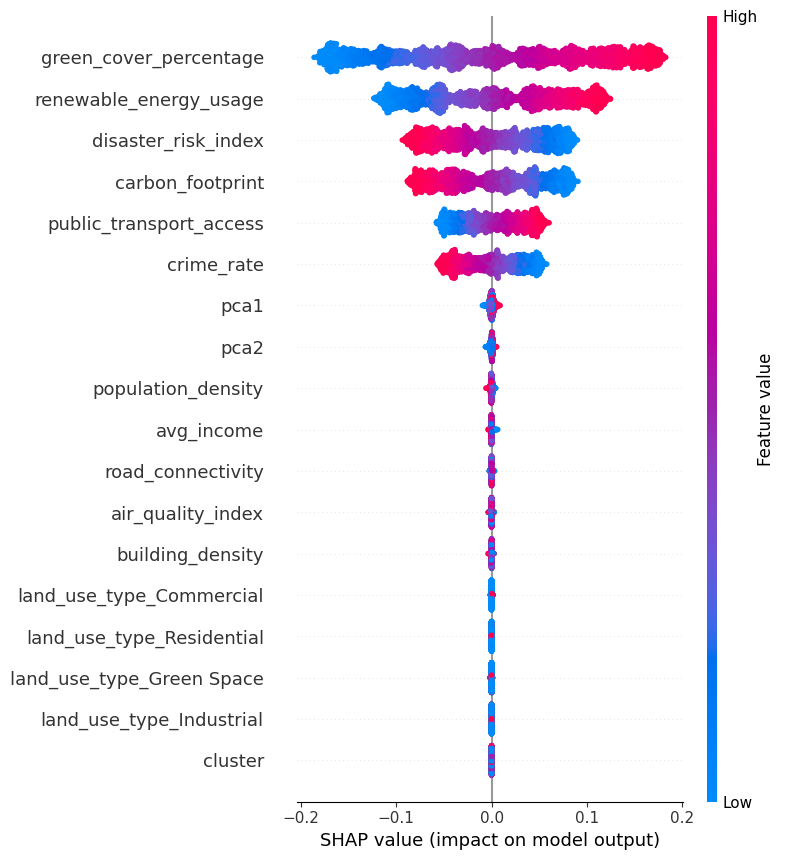

In [23]:
# SHAP EXPLAINABILITY
explainer = shap.TreeExplainer(xgb)
shap_values = explainer.shap_values(X)
shap.summary_plot(shap_values, X, plot_type="bar")
shap.summary_plot(shap_values, X)

In [25]:
# CUSTOM URBAN SUSTAINABILITY INDEX (NEW METRIC)
df["custom_sustainability_index"] = (
    0.25 * df["green_cover_percentage"] +
    0.20 * (1/df["air_quality_index"]) +
    0.20 * df["renewable_energy_usage"] +
    0.15 * (1/df["carbon_footprint"]) +
    0.20 * df["public_transport_access"]
)
px.histogram(
    df,
    x="custom_sustainability_index",
    title="Distribution of Custom Sustainability Index"
).show()

In [26]:
# WHAT-IF SIMULATION TOOL
def simulate_sustainability(green_increase=0, renewable_increase=0):
    test = X_test.copy()
    test["green_cover_percentage"] += green_increase
    test["renewable_energy_usage"] += renewable_increase
    prediction = xgb.predict(test)
    return prediction.mean()
print("Baseline:", xgb_pred.mean())
print("If green cover increases by 10:", simulate_sustainability(10,0))
print("If renewable energy increases by 5:", simulate_sustainability(0,5))

Baseline: 0.4851902
If green cover increases by 10: 0.65213585
If renewable energy increases by 5: 0.60138


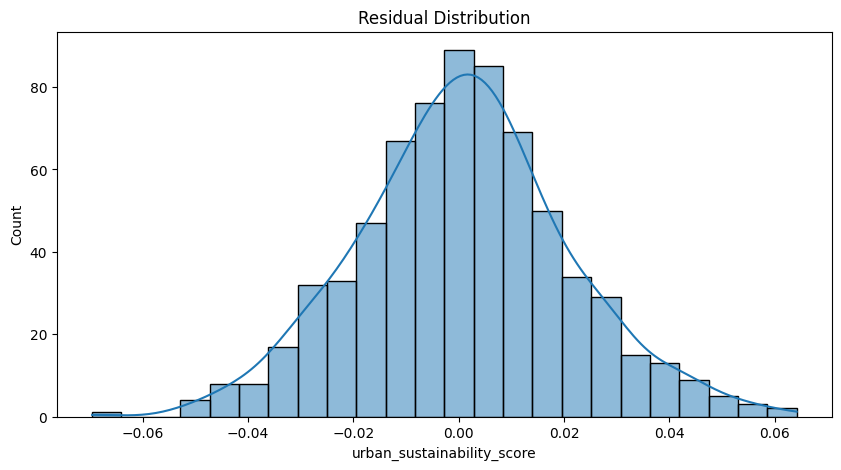

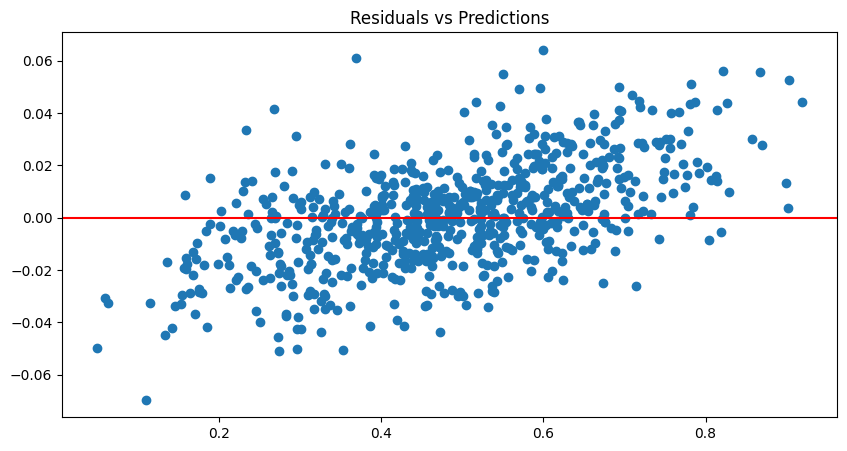

In [27]:
# RESIDUAL DIAGNOSTICS
residuals = y_test - xgb_pred
plt.figure(figsize=(10,5))
sns.histplot(residuals, kde=True)
plt.title("Residual Distribution")
plt.show()
plt.figure(figsize=(10,5))
plt.scatter(xgb_pred, residuals)
plt.axhline(0, color="red")
plt.title("Residuals vs Predictions")
plt.show()